In [58]:

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import sys
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.preprocessing import LabelEncoder

from catboost import CatBoostRegressor, Pool

from tqdm.notebook import tqdm

from joblib import Parallel, delayed
from bs4 import BeautifulSoup  as bs
from pprint import pprint  
import requests  
import json
from ast import literal_eval
import json

import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
from sklearn.preprocessing import StandardScaler

import my_func
import importlib
importlib.reload(my_func)

from IPython.display import Audio
from russian_names import RussianNames

In [59]:
!pip freeze > requirements.txt
RANDOM_SEED = 42

In [60]:
def mape(y_true, y_pred):
    return np.mean(np.abs((y_pred-y_true)/y_true))

In [61]:
pd.set_option('float_format', '{:f}'.format)
pd.set_option('display.max_colwidth', 100)

In [62]:
input_folder = 'data_versions/' 

In [63]:
train = pd.read_csv(input_folder + 'parsed_data_1.csv')
train.dropna(subset=['price'], inplace=True)


# print(data.sell_id.value_counts())
larry_data = pd.read_csv(input_folder + 'auto_ru.csv')
larry_data.drop(['complectation_dict',
                'image',
                'model_info',
                'name',
                'vehicleConfiguration',
                'vendor'], 
                axis=1, inplace=True)
larry_data.drop_duplicates(subset ="sell_id", keep = 'last', inplace = True)
larry_data = larry_data.drop(larry_data[larry_data.enginePower=='undefined N12'].index)
larry_data = larry_data.drop(larry_data[larry_data.price.isna()].index)
larry_data['sell_id'] = larry_data['sell_id'].str.replace('№ ', '')
larry_data

train = train.append(larry_data, sort=False).reset_index(drop=True) # объединяем

# Почистим от дубликатов
print('Размер до очистки от дублей', train.shape)
train.drop_duplicates(subset ="sell_id", keep = 'last', inplace = True)
print('Размер после очистки от дублей', train.shape)

test = pd.read_csv('kaggle/test.csv')

sample_submission = pd.read_csv('kaggle/sample_submission.csv')

Размер до очистки от дублей (175801, 29)
Размер после очистки от дублей (174867, 29)


In [64]:
# CATBOOST
ITERATIONS = 5000
LR         = 0.1

In [65]:
df_train = train
df_test = test
# ВАЖНО! дря корректной обработки признаков объединяем трейн и тест в один датасет
df_train['sample'] = 1 # помечаем где у нас трейн
df_test['sample'] = 0 # помечаем где у нас тест

data = df_test.append(df_train, sort=False).reset_index(drop=True) # объединяем
data.columns = ['bodyType', 'brand', 'car_url', 'color', 'complectation_dict',
       'description', 'engineDisplacement', 'enginePower', 'equipment_dict',
       'fuelType', 'image', 'mileage', 'modelDate', 'model_info', 'model_name',
       'name', 'numberOfDoors', 'parsing_unixtime', 'priceCurrency',
       'productionDate', 'sell_id', 'super_gen', 'vehicleConfiguration',
       'vehicleTransmission', 'vendor', 'owners', 'owning', 'pts', 'privod', 'wheel', 
       'state', 'customs', 'sample', 'Unnamed: 0','seller_name', 'price']

In [66]:
print('категории','\n', train.select_dtypes(np.object).columns)
print('нумерные','\n', train._get_numeric_data().columns)

категории 
 Index(['brand', 'model_name', 'enginePower', 'car_url', 'equipment_dict',
       'bodyType', 'color', 'engineDisplacement', 'fuelType', 'priceCurrency',
       'sell_id', 'super_gen', 'vehicleTransmission', 'Владельцы', 'ПТС',
       'Владение', 'Привод', 'Руль', 'Состояние', 'Таможня', 'description',
       'seller_name'],
      dtype='object')
нумерные 
 Index(['Unnamed: 0', 'productionDate', 'mileage', 'modelDate', 'numberOfDoors',
       'parsing_unixtime', 'price', 'sample'],
      dtype='object')


In [67]:
data.drop(data[data.duplicated(subset='sell_id', keep='first')].index, inplace=True)

# PREPROCESSING

In [68]:

data.drop('complectation_dict', axis=1, inplace=True, errors='ignore')
data.drop('image', axis=1, inplace=True, errors='ignore')
data.drop('model_info', axis=1, inplace=True, errors='ignore')
data.drop('name', axis=1, inplace=True, errors='ignore')
data.drop('vendor', axis=1, inplace=True, errors='ignore')
data.drop('Unnamed: 0', axis=1, inplace=True, errors='ignore')
data.drop('priceCurrency', axis=1, inplace=True, errors='ignore')
data.drop('vehicleConfiguration', axis=1, inplace=True, errors='ignore')
data.drop('super_gen', axis=1, inplace=True, errors='ignore')
data.drop('seller_name', axis=1, inplace=True, errors='ignore')
data['owners'] = data['owners'].astype('category').cat.codes

data['enginePower'] = data['enginePower'].apply(lambda x: int(x.replace(' N12', '')) if type(x)==str else x)
data['engineDisplacement'] = data['engineDisplacement'].apply(lambda x: pd.to_numeric(x.replace(' LTR', '')) if type(x)==str else x)

data.drop('customs', axis=1, inplace=True, errors='ignore')

# Выбросы

In [69]:
print('граница выбросов километража: ' ,my_func.outlier_treatment(data.mileage))
# Оставим значения свыше границы, но в пределах 400к,
# Остальные значения закодируем
data['mileage600'] = data['mileage'].apply(lambda x: 1 if x>600 else 0)
data['mileage'] = data['mileage'].apply(lambda x: 400_000 if x>400_000 else x)

граница выбросов километража:  (-176000.0, 400000.0)


# ПРОПУСКИ

In [70]:
mileage_proddate = data[data.mileage!=0].groupby(by='productionDate').mileage.mean().tail(50)
mask0milage = data['mileage']==0
data['mileage'].loc[mask0milage] = data.loc[mask0milage].productionDate.apply(lambda x: mileage_proddate[x])

In [71]:
# data.loc[mask0milage].productionDate.value_counts()

In [72]:
# Просто сносим пропуски, где их незначительно мало

data.dropna(subset=['bodyType'], inplace=True)
data.dropna(subset=['enginePower'], inplace=True)


In [73]:
# Заполняем 
data['color'].fillna(method='ffill', inplace=True)

data['owners'] = data['owners'] + 1 # пока будем считать, что NaN это машины без проката, 
                                    # т.е. оставим присвоенные после кодировки значения, прибавив к всему столбу 1, 
                                    # чтобы выравнить до неотрицательных по всей колонке

data['equipment_dict'].fillna('{"not_specified":true}', inplace=True)
# data['owning'].fillna('0', inplace=True)
data['pts'].fillna('0', inplace=True)

data['wheel'].fillna('not_specified', inplace=True)
data['privod'].fillna('not_specified', inplace=True)
data['state'].fillna('not_specified', inplace=True)


data.description.fillna('пусто', inplace=True)
# data['customs'].fillna('not_specified', inplace=True)

In [74]:
# Обработка даты
def str_timedelta(string):
    import re
    string = string.replace(' года', 'Y')
    string = string.replace(' лет', 'Y')
    string = string.replace(' год', 'Y')
    string = string.replace(' и ', '')
    string = string.replace(' месяца', 'm')
    string = string.replace(' месяцев', 'm')
    string = string.replace(' месяц', 'm')
    try:
        year_part = int(re.findall(r"(\d+)m", string)[-1]) / 12
        year_part = str(round(year_part, 3)) + 'y'
    except:
        year_part = 0
    td_y = pd.to_timedelta(string).days
    td_m = pd.to_timedelta(year_part).days
    td = td_y + td_m
    return td

mask = data.owning.isna()==False
data['owning'].loc[mask] = data['owning'].loc[mask].map(str_timedelta)
data['owning'].loc[mask] = pd.to_numeric(data['owning'].loc[mask])
data['owning'].fillna(0, inplace=True)


# data.drop('owning', axis=1, inplace=True, errors='ignore')

In [75]:
print('категории','\n', data.select_dtypes(np.object).columns)
print('нумерные','\n', data._get_numeric_data().columns)

категории 
 Index(['bodyType', 'brand', 'car_url', 'color', 'description',
       'equipment_dict', 'fuelType', 'model_name', 'sell_id',
       'vehicleTransmission', 'pts', 'privod', 'wheel', 'state'],
      dtype='object')
нумерные 
 Index(['engineDisplacement', 'enginePower', 'mileage', 'modelDate',
       'numberOfDoors', 'parsing_unixtime', 'productionDate', 'owners',
       'owning', 'sample', 'price', 'mileage600'],
      dtype='object')


In [76]:
cat_features_ids = ['bodyType', 'brand', 'color','descr_labels', 'fuelType', 
                    'model_name', 'vehicleTransmission',
                    'pts', 'privod', 'wheel', 'state']

# Кодирование


In [77]:
# Catboost работает с категорийными признаками в исходном виде, 
# поэтому кодировать ничего не будем

# Feature Genering

In [78]:
print('категории','\n', data.select_dtypes(np.object).columns)
print('нумерные','\n', data._get_numeric_data().columns)

категории 
 Index(['bodyType', 'brand', 'car_url', 'color', 'description',
       'equipment_dict', 'fuelType', 'model_name', 'sell_id',
       'vehicleTransmission', 'pts', 'privod', 'wheel', 'state'],
      dtype='object')
нумерные 
 Index(['engineDisplacement', 'enginePower', 'mileage', 'modelDate',
       'numberOfDoors', 'parsing_unixtime', 'productionDate', 'owners',
       'owning', 'sample', 'price', 'mileage600'],
      dtype='object')


In [79]:
data['engpower_doors'] = data['enginePower'] * data['numberOfDoors']

data['engpower_endisp'] = data['enginePower'].apply(int) * data['engineDisplacement']

data['engpower_owners'] = data['enginePower'] * data['owners']

data['prod-model-date'] = data['productionDate'] - data['modelDate']

In [80]:
data['equipment_dict'] = data.apply(lambda r: list(literal_eval(r['equipment_dict']).keys()) 
                                              if r['sample']==1 else 
                                                  list(json.loads(r['equipment_dict']).keys()), 
                                              axis=1)

In [81]:
data['car_used'] = data['car_url'].apply(lambda x: 1 if 'used' in x else 0)
mask_d = data['car_url'].str.contains('new')
data['description'].loc[mask_d] = 'реклама'
data.drop('car_url', axis=1, inplace=True, errors='ignore')

In [82]:
d_brand_price = dict(data.groupby(by='brand').price.mean())
data['brand_price'] = data['brand'].apply(lambda x: d_brand_price[x])

d_bodyType_price = dict(data.groupby(by='bodyType').price.mean())
data['body_price'] = data['bodyType'].apply(lambda x: d_bodyType_price[x])

d_model_name_price = dict(data.groupby(by='model_name').price.mean())
data['model_name_price'] = data['model_name'].apply(lambda x: d_model_name_price[x])

In [83]:
data[['brand_price', 
      'body_price', 
      'model_name_price']] = data[['brand_price', 
                                   'body_price', 
                                   'model_name_price']].apply(np.log)

In [84]:
d_brand_mileage = dict(data.groupby(by='brand').mileage.mean())
data['brand_mileage'] = data['brand'].apply(lambda x: d_brand_mileage[x])

d_model_name_mileage = dict(data.groupby(by='model_name').mileage.mean())
data['model_name_mileage'] = data['model_name'].apply(lambda x: d_model_name_mileage[x])

In [85]:
data['equip_len'] = data['equipment_dict'].apply(len)

# NLP

In [86]:
# import nltk
# nltk.download('stopwords')

In [87]:
data['description'].loc[data.description.apply(len)<=3] = 'пусто'
data['description'].loc[data.description.apply(len)==4] = 'торг'
data['description'].loc[data.description.apply(len)==5] = 'пусто'

In [88]:
# data['description'].loc[data.description.apply(len)==6].value_counts()
from my_func import list_trash_ind
data['description'].loc[list_trash_ind] = 'пусто'

In [89]:
from sklearn.feature_extraction.text import CountVectorizer
from nltk.corpus import stopwords
stopWords = stopwords.words('russian')
# Создаём объект, который будет токенизировать данные
analyzer = CountVectorizer(stop_words=stopWords,
                           lowercase=True,
                           
                            ).build_analyzer()
# Токенизируем наш набор данных
data['description'] = data.description.apply(analyzer)

In [90]:
from gensim.models import Word2Vec
# Обучаем модель векторайзера на нашем наборе данных
# На выходе мы получим вектор признаков для каждого слова
model = Word2Vec(data['description'].loc[:], min_count=20, size=30, seed=RANDOM_SEED)

In [91]:
# Наивный подход к созданию единого эмбеддинга для документа – средний эмбеддинг по словам

# Составляем эмбеддинги для наших объявлений
data['description'] = data.description.apply(lambda x: my_func.doc_vectorizer(x, model))

In [92]:
# data = data.drop(list(data['description'].loc[data.description.apply(len)<5].index))
# list(data['description'].loc[data.description.apply(len)<5].index)

In [93]:
from sklearn import metrics
from sklearn.cluster import KMeans

CLUSTERS = 5

# Создаём KMeans кластеризатор 
kmeans = KMeans(n_clusters=CLUSTERS, random_state=RANDOM_SEED)
# Обучим кластеризатор на подготовленных данных 
data['descr_labels'] = kmeans.fit_predict(np.asarray(list(data['description'].values)))

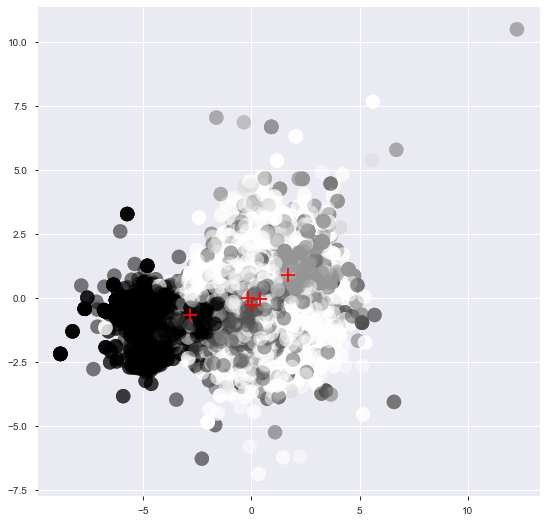

In [94]:
# Графики полученных кластеров
X = np.asarray(list(data['description'].values) )

y_pred = kmeans.labels_.astype(np.int)
colors = ("red", "green", "blue", "yellow")
plt.rcParams['figure.figsize'] = 9,9
plt.scatter(X[:, 0], X[:, 1], c=y_pred, s=200, alpha=.5)
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], c='red', s=200, marker='+')
plt.show()

In [95]:
data.drop('description', axis=1, inplace=True, errors='ignore')

In [96]:
cat_features_ids = ['bodyType', 'brand', 'color', 'fuelType', 
                    'model_name', 'vehicleTransmission',
                    'pts', 'privod', 'wheel', 'state', 'descr_labels']

(194803, 36)

# DUMMY

In [97]:
# for_dummy_cols = ['fuelType',  'vehicleTransmission', 'pts']
# data = pd.get_dummies(data, columns=for_dummy_cols, drop_first=False)

In [98]:
data['equipment_dict'] = data['equipment_dict'].apply(lambda x: ['not_specified'] if len(x)==0 else x)
equip_set = set()
data.equipment_dict.apply(lambda x: equip_set.update(x))
equips_df = pd.DataFrame(columns=list(equip_set), data=np.zeros((data.shape[0], len(equip_set))), dtype=int)
data = pd.concat([equips_df, data], axis=1, join='inner')
for i in range(data.shape[0]):
    for equip in data.equipment_dict.iloc[i]:
        data[equip].iloc[i] = 1

data.drop('equipment_dict', axis=1, inplace=True, errors='ignore')

# Normalize

In [99]:
# scaler = StandardScaler().fit(data.mileage)
data[['mileage', 'enginePower']] = StandardScaler().fit_transform(data[['mileage', 'enginePower']].values)

# Подготовка данных для модели

In [100]:
# data.to_csv('data_for_stacking.csv')

In [101]:
# data.drop('sell_id', axis=1, inplace=True, errors='ignore')

X = data.query('sample == 1').drop(['sample'], axis=1)
y = X['price']

X.drop('price', axis=1, inplace=True, errors='ignore')
X_sub = data.query('sample == 0').drop(['sample', 'price'], axis=1)

In [102]:
VAL_SIZE=0.20
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=VAL_SIZE, shuffle=True, random_state=RANDOM_SEED)

In [103]:
y_train = np.log(y_train)
y_test = np.log(y_test)

In [104]:
# CHANGEs COMMENT
changes_comment = 'depth12 LR0.05'

In [105]:
# data.drop(data[data.duplicated(subset='sell_id', keep='first')].index, inplace=True)

In [106]:
print(data.duplicated(subset='sell_id', keep='first').value_counts())
data.to_csv('data_for_stacking.csv')

False    180053
dtype: int64


# MODEL

In [107]:
# CATBOOST

catboost_params = {
    'iterations': 5000,
    'learning_rate': 0.06,
    'depth': 12,
    'random_seed': RANDOM_SEED,
    'eval_metric': 'MAPE',
    'custom_metric': ['R2', 'MAE'],
    'l2_leaf_reg': 1

}

ITERATIONS = 5000
LR         =  0.05775539388456 # 0.08343057119918101 #0.09399760402267439 #0.1
depth = 12 # 4 # 8 #12

In [108]:
train_pool = Pool(
    X_train,
    y_train,
    cat_features=cat_features_ids,
) 
test_pool = Pool(
    X_test,
    y_test,
    cat_features=cat_features_ids,
)

model = CatBoostRegressor(iterations = catboost_params['iterations'],
                          learning_rate = catboost_params['learning_rate'],
                          random_seed = RANDOM_SEED,
                          eval_metric=catboost_params['eval_metric'],
                          custom_metric=catboost_params['custom_metric'],
                          l2_leaf_reg=catboost_params['l2_leaf_reg'],
                          depth=catboost_params['depth'],
                          metric_period=catboost_params['depth'],
                          od_type='Iter',
                          od_wait=20,
                          rsm=0.2,
                          devices='GPU'
                         )
model.fit(train_pool,
         eval_set=test_pool,
         verbose_eval=catboost_params['depth']*4,
         use_best_model=True,
         plot=False
         )

0:	learn: 0.0702697	test: 0.0704211	best: 0.0704211 (0)	total: 347ms	remaining: 28m 55s
48:	learn: 0.0129392	test: 0.0131873	best: 0.0131873 (48)	total: 16.9s	remaining: 28m 25s
96:	learn: 0.0106143	test: 0.0110443	best: 0.0110443 (96)	total: 33.2s	remaining: 28m
144:	learn: 0.0098474	test: 0.0104870	best: 0.0104870 (144)	total: 49.5s	remaining: 27m 38s
192:	learn: 0.0092825	test: 0.0101141	best: 0.0101141 (192)	total: 1m 5s	remaining: 27m 8s
240:	learn: 0.0088258	test: 0.0098470	best: 0.0098470 (240)	total: 1m 20s	remaining: 26m 27s
288:	learn: 0.0084199	test: 0.0096396	best: 0.0096396 (288)	total: 1m 35s	remaining: 25m 52s
336:	learn: 0.0080971	test: 0.0094912	best: 0.0094912 (336)	total: 1m 49s	remaining: 25m 19s
384:	learn: 0.0078037	test: 0.0093549	best: 0.0093549 (384)	total: 2m 4s	remaining: 24m 50s
432:	learn: 0.0075427	test: 0.0092446	best: 0.0092446 (432)	total: 2m 18s	remaining: 24m 23s
480:	learn: 0.0072843	test: 0.0091412	best: 0.0091412 (480)	total: 2m 32s	remaining: 23m 

<AxesSubplot:ylabel='Feature Id'>

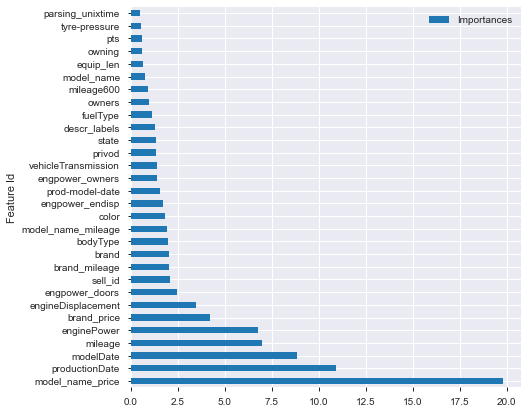

In [109]:
plt.rcParams['figure.figsize'] = 7,7
imp_features = model.get_feature_importance(prettified=True)[:30]
imp_features.sort_values(by='Importances',inplace=True, ascending=False)
imp_features.set_index('Feature Id', inplace=True)
imp_features.plot(kind='barh')

In [110]:
predict = model.predict(X_test)

predict = np.e ** predict
y_test = np.e ** y_test

# оцениваем точность
MAPE = f'{(mape(y_test, predict))*100:0.4f}'
print(f"Точность модели по метрике MAPE: {MAPE}%")

Точность модели по метрике MAPE: 9.5017%


In [111]:
predict_1 = np.round(predict // 10000) * 10000
MAPE10k = f'{(mape(y_test, predict_1))*100:0.4f}'
print(f"Точность модели по метрике MAPE: {MAPE10k}%")

Точность модели по метрике MAPE: 9.3697%


In [112]:
predict_2 = predict // 1000 * 1000
MAPE = f'{(mape(y_test, predict_2))*100:0.4f}'
print(f"Точность модели по метрике MAPE: {MAPE}%")

Точность модели по метрике MAPE: 9.4734%


In [113]:
import winsound
freq = 2000 # Set frequency To 2500 Hertz
dur = 700 # Set duration To 1000 ms == 1 second
winsound.Beep(freq, dur) 

# SUBMISSION

In [114]:
MAPE10k = MAPE
print('update sub version')
version_ser = pd.read_csv('kaggle/submissions_kaggle/sub_version.csv', index_col=0)
new_version = version_ser['sub_version'].loc[0] + 1
new_version_list = pd.DataFrame({'sub_version': new_version, 'sub_dt' : pd.Timestamp.today(), 'MAPE': MAPE , 'MAPE10k': MAPE10k, 'comment': changes_comment}, index =[0])
version_ser = pd.concat([new_version_list, version_ser[:]]).reset_index(drop = True)
version_ser.to_csv('kaggle/submissions_kaggle/sub_version.csv', index='index')

update sub version


In [115]:
pd.set_option('display.expand_frame_repr', False)
print(version_ser.head(10))

   sub_version                      sub_dt     MAPE  MAPE10k                               comment
0          111  2020-12-16 19:30:33.759460   9.4734   9.4734                        depth12 LR0.05
1          110  2020-12-16 18:44:33.246667 3.120300 3.120300                        depth12 LR0.05
2          109  2020-12-16 13:49:08.348679 9.566100 9.478700                        depth12 LR0.05
3          108  2020-12-14 19:31:03.662375 9.560800 9.454200                        depth12 LR0.05
4          107  2020-12-13 20:42:06.725556 9.477200 9.339600                        depth12 LR0.05
5          106  2020-12-13 20:03:45.517970 9.209000 9.119300                        depth12 LR0.05
6          105  2020-12-10 12:14:38.844103 9.234600 9.150700  depth12 LR0.05 add-EqupLen dropEquip
7          104  2020-12-10 01:07:59.229699 9.258600 9.169300  depth12 LR0.05 add-EqupLen dropEquip
8          103  2020-12-10 00:05:37.296006      NaN      NaN  depth12 LR0.05 add-EqupLen dropEquip
9         

In [116]:
predict_submission = model.predict(X_sub)
predict_submission = np.e ** predict_submission
predict_submission = predict_submission // 10000 * 10000
sample_submission['price'] = predict_submission
sample_submission.to_csv(f'kaggle\submissions_kaggle\submission_{new_version}.csv', index=False)
sample_submission.head(5)

,sell_id,price
0,1100575026,620000.000000
1,1100549428,1030000.000000
2,1100658222,910000.000000
3,1100937408,790000.000000
4,1101037972,740000.000000


In [117]:
# data.to_csv('data_for_stacking.csv')

# Изучаем ошибки

In [118]:
# pd.DataFrame(columns=['predict', 'true'] , data=[predict, y_test.values])
errors = {'index': y_test.index,'true': y_test.values, 'predict': predict, 'diffr': (y_test.values - predict)}
errors = pd.DataFrame(errors)
errors['diffr'].mean()

20505.335870084837

In [119]:
errors[abs(errors['diffr']).between(500_000, 70000_000)].true.mean()
abs(errors['diffr']).sort_values(ascending=False).head(20)

12799   49273838.852175
15340   48718329.675535
8483    46345381.073201
27512   16405973.911189
5911    14623009.869561
19933   13414905.324524
22601   10791065.515341
10175   10683687.215922
22430    9936405.340766
4507     9111290.389976
8937     8931090.450781
7994     7450920.158861
12675    7110735.329167
6162     6128610.693668
9674     5359201.186424
10511    5301413.879583
470      5234094.626319
27556    5138831.536658
9019     4986658.700568
14578    4950603.590488
Name: diffr, dtype: float64

In [120]:
errors[abs(errors['diffr']).between(500_000, 70000_000)]['diffr'].mean()

720752.7385488122

In [121]:
errors[errors['diffr']>600_000][['true','diffr']].mean()

true    8676691.814493
diffr   2022496.122322
dtype: float64

(array([-5.,  0.,  5., 10., 15., 20., 25., 30.]),
 [Text(-5.0, 0, '(36743510.204, 38212530.612]'),
  Text(0.0, 0, '(18000.0, 1487020.408]'),
  Text(5.0, 0, '(7363102.041, 8832122.449]'),
  Text(10.0, 0, '(14708204.082, 16177224.49]'),
  Text(15.0, 0, '(22053306.122, 23522326.531]'),
  Text(20.0, 0, '(30867428.571, 32336448.98]'),
  Text(25.0, 0, '(57309795.918, 58778816.327]'),
  Text(30.0, 0, '')])

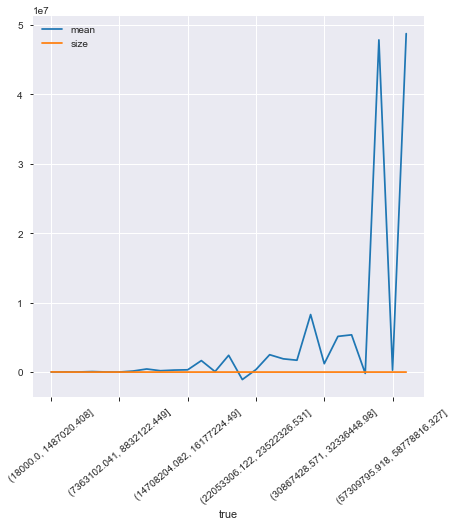

In [122]:
bins = np.linspace(errors.true.min(), errors.true.max(), 50)
groups = errors.groupby(pd.cut(errors.true, bins))


# groups.mean()
plt.rcParams['figure.figsize'] = 7,7

groups[['diffr']].agg([np.mean, np.size]).dropna().reset_index().plot(x='true', y='diffr')
plt.xticks(rotation=40)
# errors.groupby(by='diffr').mean()

In [123]:
train = pd.read_csv(input_folder + 'parsed_data_1.csv')
train.dropna(subset=['price'], inplace=True)
# Почистим от дубликатов

# print(data.sell_id.value_counts())
print('Размер до очистки от дублей', train.shape)
train.drop_duplicates(subset ="sell_id", keep = False, inplace = True)
print('Размер после очистки от дублей', train.shape)

test = pd.read_csv('kaggle/test.csv')
# test.dropna(subset=['price'], inplace=True)

sample_submission = pd.read_csv('kaggle/sample_submission.csv')

df_train = train
df_test = test
# ВАЖНО! дря корректной обработки признаков объединяем трейн и тест в один датасет
df_train['sample'] = 1 # помечаем где у нас трейн
df_test['sample'] = 0 # помечаем где у нас тест

data_errors = df_test.append(df_train, sort=False).reset_index(drop=True) # объединяем
data_errors.columns = ['bodyType', 'brand', 'car_url', 'color', 'complectation_dict',
       'description', 'engineDisplacement', 'enginePower', 'equipment_dict',
       'fuelType', 'image', 'mileage', 'modelDate', 'model_info', 'model_name',
       'name', 'numberOfDoors', 'parsing_unixtime', 'priceCurrency',
       'productionDate', 'sell_id', 'super_gen', 'vehicleConfiguration',
       'vehicleTransmission', 'vendor', 'owners', 'owning', 'pts', 'privod', 'wheel', 
       'state', 'customs', 'sample', 'Unnamed: 0','seller_name', 'price']

Размер до очистки от дублей (88297, 29)
Размер после очистки от дублей (86429, 29)


<AxesSubplot:>

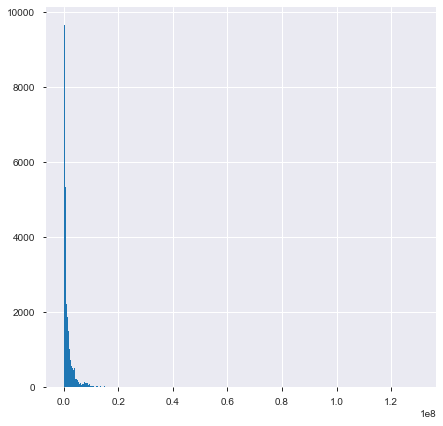

In [124]:
data_errors['price'].hist(bins=1000)